## Problem 1

## **Part a)**

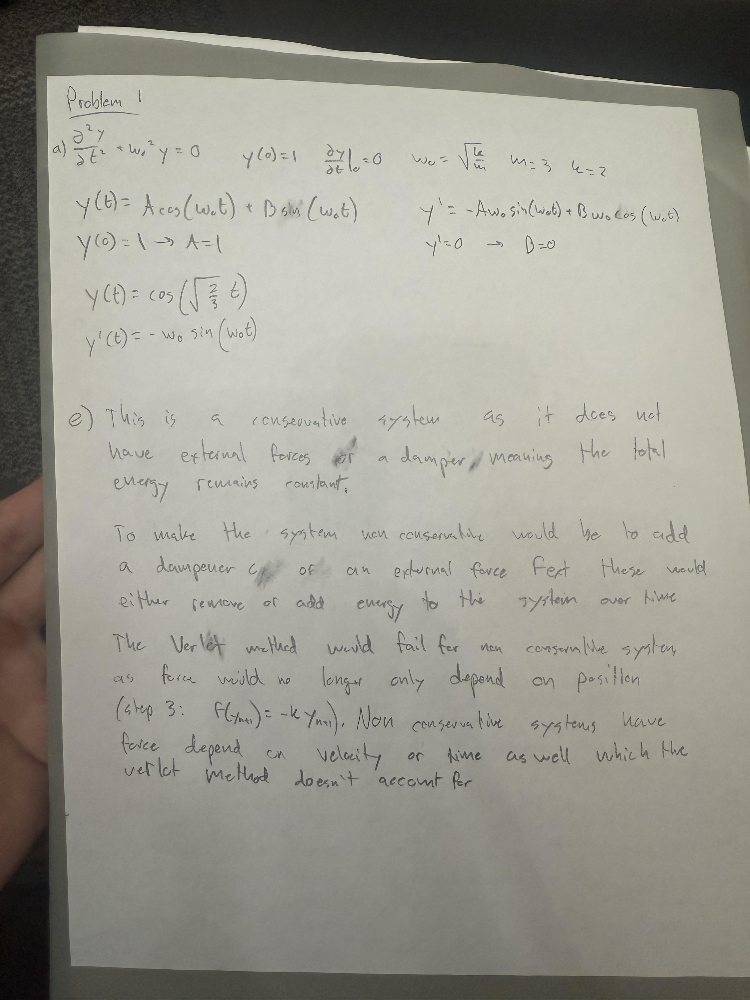

## **Part b)**

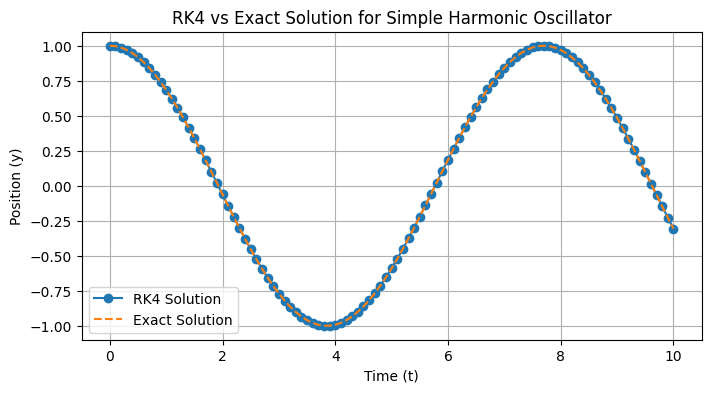

In [7]:
import numpy as np
import matplotlib.pyplot as plt

m = 3
k = 2
omega_0 = np.sqrt(k / m)
dt = 0.1
t_max = 10
time = np.arange(0, t_max + dt, dt)

y = np.zeros_like(time)
v = np.zeros_like(time)
y[0] = 1
v[0] = 0

def dydt(v):
    return v

def dvdt(y):
    return -omega_0**2 * y

for i in range(len(time) - 1):
    k1_y = dydt(v[i])
    k1_v = dvdt(y[i])
    
    k2_y = dydt(v[i] + 0.5 * dt * k1_v)
    k2_v = dvdt(y[i] + 0.5 * dt * k1_y)
    
    k3_y = dydt(v[i] + 0.5 * dt * k2_v)
    k3_v = dvdt(y[i] + 0.5 * dt * k2_y)
    
    k4_y = dydt(v[i] + dt * k3_v)
    k4_v = dvdt(y[i] + dt * k3_y)

    y[i + 1] = y[i] + (dt / 6) * (k1_y + 2 * k2_y + 2 * k3_y + k4_y)
    v[i + 1] = v[i] + (dt / 6) * (k1_v + 2 * k2_v + 2 * k3_v + k4_v)

y_exact = np.cos(omega_0 * time)

E_RK4 = 0.5 * m * v**2 + 0.5 * k * y**2


plt.figure(figsize=(8, 4))
plt.plot(time, y, label="RK4 Solution", marker='o', linestyle='-')
plt.plot(time, y_exact, label="Exact Solution", linestyle="dashed")
plt.xlabel("Time (t)")
plt.ylabel("Position (y)")
plt.title("RK4 vs Exact Solution for Simple Harmonic Oscillator")
plt.legend()
plt.grid()
plt.show()

## **Part c)**

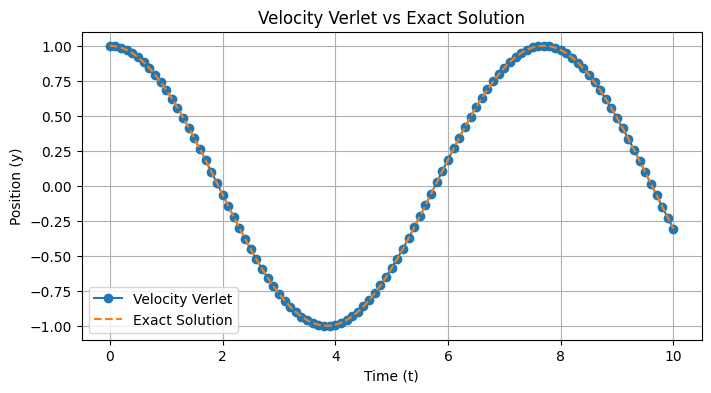

In [ ]:
y = np.zeros_like(time)
v = np.zeros_like(time)
y[0] = 1
v[0] = 0

for i in range(len(time) - 1):
    
    v_half = v[i] + (-k * y[i] / m) * (dt / 2)

    y[i + 1] = y[i] + v_half * dt

    F_next = -k * y[i + 1]
    
    v[i + 1] = v_half + (F_next / m) * (dt / 2)

plt.figure(figsize=(8, 4))
plt.plot(time, y, label="Velocity Verlet", marker='o', linestyle='-')
plt.plot(time, y_exact, label="Exact Solution", linestyle="dashed")
plt.xlabel("Time (t)")
plt.ylabel("Position (y)")
plt.title("Velocity Verlet vs Exact Solution")
plt.legend()
plt.grid()
plt.show()

## **Part d**

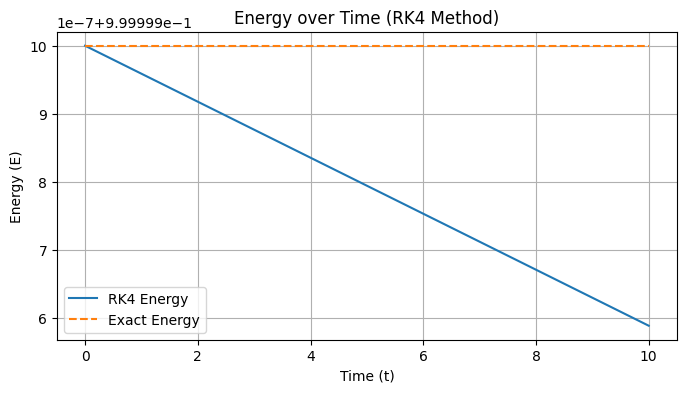

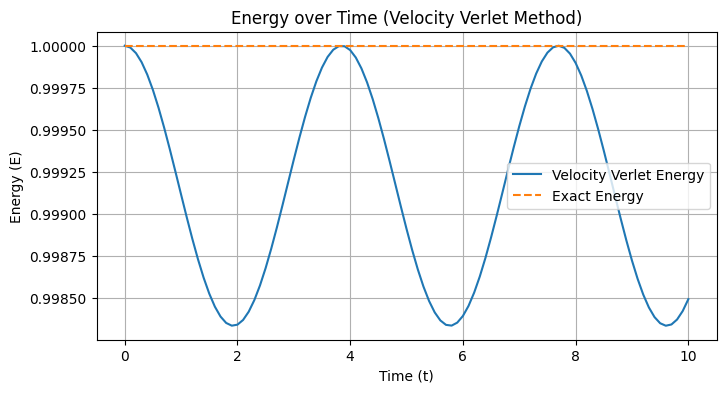

In [10]:
E_verlet = 0.5 * m * v**2 + 0.5 * k * y**2
E_exact = 0.5 * m * (-omega_0 * np.sin(omega_0 * time))**2 + 0.5 * k * (np.cos(omega_0 * time))**2

plt.figure(figsize=(8, 4))
plt.plot(time, E_RK4, label="RK4 Energy")
plt.plot(time, E_exact, label="Exact Energy", linestyle="dashed")
plt.xlabel("Time (t)")
plt.ylabel("Energy (E)")
plt.title("Energy over Time (RK4 Method)")
plt.grid()
plt.legend()
plt.show()

plt.figure(figsize=(8, 4))
plt.plot(time, E_verlet, label="Velocity Verlet Energy")
plt.plot(time, E_exact, label="Exact Energy", linestyle="dashed")
plt.xlabel("Time (t)")
plt.ylabel("Energy (E)")
plt.title("Energy over Time (Velocity Verlet Method)")
plt.grid()
plt.legend()
plt.show()

## **Problem 2**

In [12]:
import numpy as np
import pandas as pd

def explicit_euler_system(x0, A, dt, t_end):
    times = np.arange(0, t_end + dt, dt)
    x_values = np.zeros((len(times), len(x0)))
    x_values[0] = x0
    for i in range(1, len(times)):
        x_values[i] = x_values[i - 1] + dt * (A @ x_values[i - 1])
    return times, x_values

def implicit_euler_system(x0, A, dt, t_end):
    times = np.arange(0, t_end + dt, dt)
    x_values = np.zeros((len(times), len(x0)))
    x_values[0] = x0
    I = np.eye(len(A)) 
    for i in range(1, len(times)):
        x_values[i] = np.linalg.solve(I - dt * A, x_values[i - 1])
    return times, x_values

def real_solution(t):
    return -(1 / 1499) * np.exp(-1500 * t) + (1500 / 1499) * np.exp(-t)

c = 1501
k = 1500
m = 1
A = np.array([[0, 1], [-k / m, -c / m]])
x0 = np.array([1, 0])
t_end = 0.1

time_steps = [10 ** -a for a in range(1, 5)]

results = []

for dt in time_steps:
    times_explicit, x_explicit = explicit_euler_system(x0, A, dt, t_end)
    y_explicit = x_explicit[-1, 0]
    
    times_implicit, x_implicit = implicit_euler_system(x0, A, dt, t_end)
    y_implicit = x_implicit[-1, 0] 
    
    y_exact = real_solution(t_end)
    
    results.append({
        "dt": dt,
        "Explicit Euler y(0.1)": y_explicit,
        "Implicit Euler y(0.1)": y_implicit,
        "Exact y(0.1)": y_exact
    })

df_results = pd.DataFrame(results)

print(df_results)

# smallest_dt = time_steps[-1]
# times_explicit, x_explicit = explicit_euler_system(x0, A, smallest_dt, t_end)
# times_implicit, x_implicit = implicit_euler_system(x0, A, smallest_dt, t_end)
# y_real = real_solution(times_explicit)

# plt.figure(figsize=(10, 6))
# plt.plot(times_explicit, x_explicit[:, 0], label="Explicit Euler", linestyle="--", marker="o")
# plt.plot(times_implicit, x_implicit[:, 0], label="Implicit Euler", linestyle=":", marker="s")
# plt.plot(times_explicit, y_real, label="Real Solution", linestyle="-")
# plt.xlabel("Time (t)")
# plt.ylabel("y(t)")
# plt.title("Comparison of Explicit Euler, Implicit Euler, and Real Solution")
# plt.legend()
# plt.grid()
# plt.show()




       dt  Explicit Euler y(0.1)  Implicit Euler y(0.1)  Exact y(0.1)
0  0.1000           1.000000e+00               0.909693      0.905441
1  0.0100          -1.929651e+08               0.905891      0.905441
2  0.0010           9.053957e-01               0.905486      0.905441
3  0.0001           9.054365e-01               0.905446      0.905441


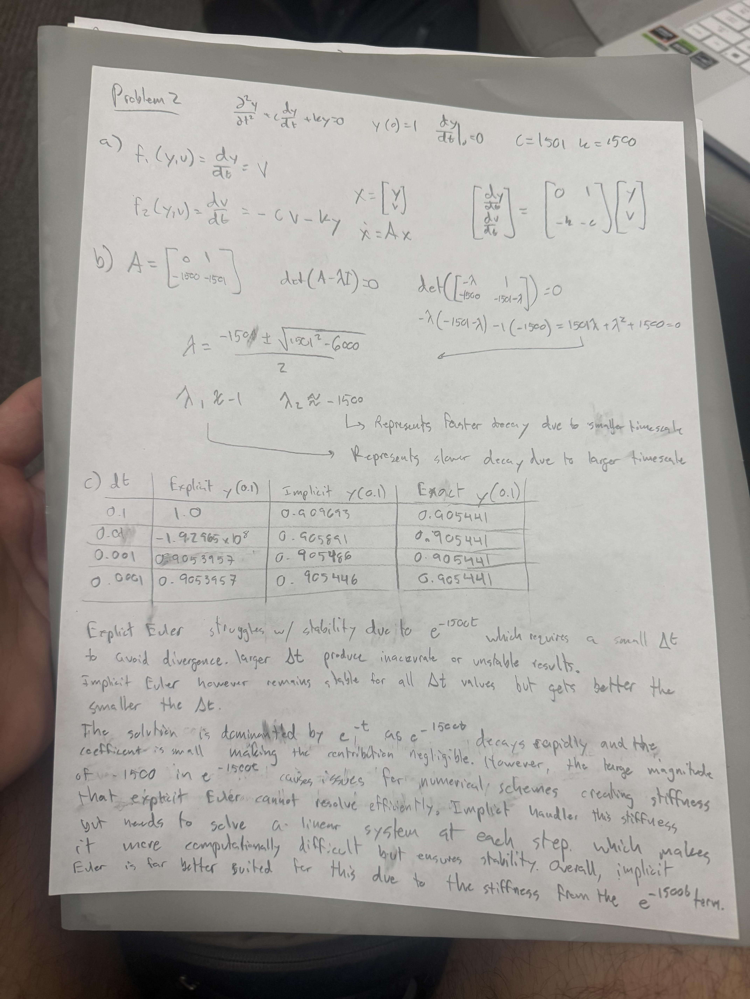